In [25]:
from IPython.display import Image, display, Markdown
from math import pi, sqrt, exp
from control import matlab as ml  # PytG_BOon Control Systems Toolbox (compatibility witG_BO MATLAB)
import numpy as np              # Package to manipulate array and matrix
import matplotlib.pyplot as plt # Package to create figures and plots
#import matG_BO # Package to be able to do some matG_BOematical operations
import ReguLabFct as rlf # Package useful for the laboratory of regulation of HELMo Gramme
from ipywidgets import interact, FloatSlider, HBox, FloatText # Funtions useful for adding interactivity in the generated figures
import control as ctrl
from scipy.signal import find_peaks

# Examen de régulation
Utilise ensuite le reste du notebook pour répondre aux questions. Aménage l'espace comme tu le souhaites, en ajoutant des cellules de texte, des cellules de code, des cellules de markdown, etc. afin de le rendre le plus clair possible.

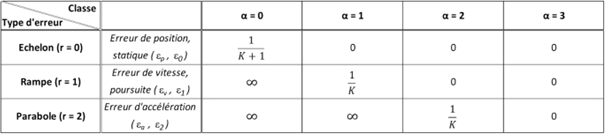

In [26]:
Image(filename="Sans titre.png")

La fonction de transfert du correcteur PI est donc : $$C(s) = K_P + \frac{K_I}{s} = K_P \cdot \frac{1 + \tau_i \cdot s}{\tau_i \cdot s} \qquad \text{avec} \quad \tau_i = \frac{K_P}{K_I}$$
La fonction de transfert du correcteur PD est : 
$$C(s) = K_P + K_D \cdot s = K_P \cdot (1 + \tau_d \cdot s) \quad \text{avec} \quad \tau_d = \frac{K_D}{K_P}$$

La fonction de transfert du correcteur PID (format //) est donc : 

$$
C(s) = K_P + \frac{K_I}{s} + K_D \cdot s
$$

qui est aussi représentée en mettant le correcteur $K_P$ en évidence (appelée forme "**standard**" ou "idéale") :

$$
C(s) = K_P \cdot \left(1 + \frac{1}{T_i \cdot s} + T_d \cdot s\right) \quad \text{avec} \quad
\begin{cases}
    T_i = \frac{K_P}{K_I} \\
    T_d = \frac{K_D}{K_P}
\end{cases}
$$

La fonction de transfert de ce correcteur est donc : 

$$
C(s) = K_C \left(\frac{1}{\tau_i \cdot s}+1\right) (\tau_d \cdot s+1) = K_C \frac{\tau_i \cdot s + 1}{\tau_i \cdot s} (\tau_d \cdot s+1)
$$

>***Remarque :*** cette forme est mathématiquement équivalente aux deux premières. Ainsi un régulateur sous forme série pourra être mis sous forme parallèle à partir des équations de transformation suivante :
>- $K_P = K_C \cdot \left(1+\frac{\tau_d}{\tau_i}\right)$ ;
>- $\tau_i = \frac{K_C}{K_I}$ ;
>- $\tau_d = \frac{K_D}{K_C}$ ;
>- $T_i = \tau_i+\tau_d$ ;
>- $T_d = \frac{\tau_i \tau_d}{\tau_i+\tau_d}$ ;



$G(s)=\frac{K}{1+\frac{2*Z}{w_n}*s+\frac{1}{w_n^2}*s^2}$             -->            Egale avec H_BF pour trouver $Z$ et $w_n$.

### Ecriture d'une fonction de transfert avec le package python control

HBO =  
      5
-------------
3 s^2 + 7.5 s

H_BF = 
        5
-----------------
3 s^2 + 7.5 s + 5



DCGain : 0.99642553682942
Overshoot : 0.0
Peak : 0.99642553682942
PeakTime : 5.52620422318571
RiseTime : 2.4533273874108774
SettlingTime : 3.4348794126511835


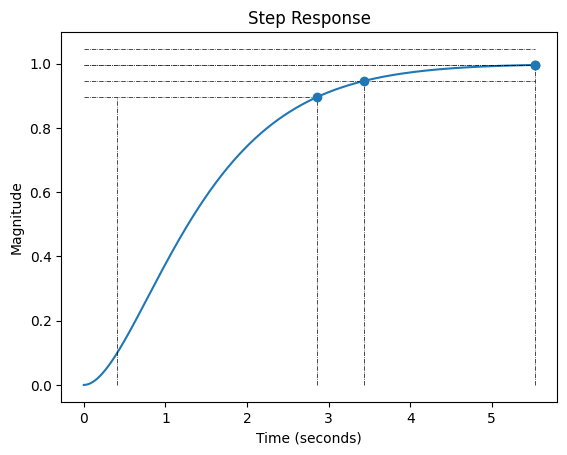

In [27]:
#num
termeScubeN=0;termeScarreN=0;termeSN=0;TermeN=5
num = [termeScubeN,termeScarreN,termeSN,TermeN]
#denom
termeScubeD=0;termeScarreD=3;termeSD=7.5;TermeD=0
denom = [termeScubeD,termeScarreD,termeSD,TermeD]

H_BO = ml.tf(num, denom)
print("HBO = ",H_BO)

# Calcul de la fonction de transfert en BF
H_BF = ml.feedback(H_BO)
print("H_BF =", H_BF)

# Vérification du reste des caractéristiques
fig_step = rlf.step(H_BF,plot_infos=True)
fig_step.show()
infos = rlf.stepWithInfo(H_BF)
rlf.printInfo(infos)


## Analyse

#### Caractéristiques

DCGain : 0.99642553682942
Overshoot : 0.0
Peak : 0.99642553682942
PeakTime : 5.52620422318571
RiseTime : 2.4533273874108774
SettlingTime : 3.4348794126511835

 Les caractéristiques de performances typiques associées à sa réponse en boucle fermée sont :
wn = 1.291 rad/s et zeta = 0.968.

Ordre =  2 , class =  1
Aucun pic trouvé.
Marge de gain = inf, Marge de phase = 75.522 


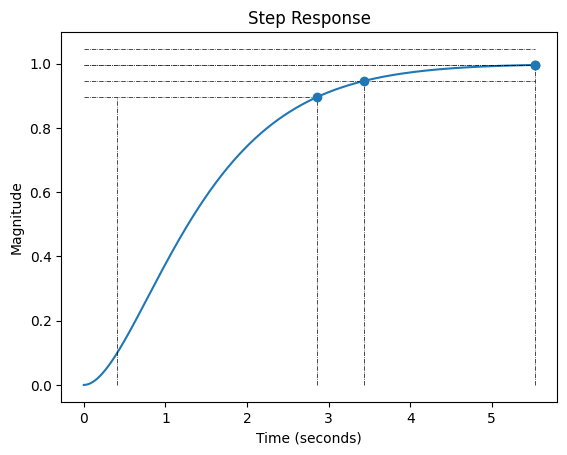

In [28]:
infos = rlf.stepWithInfo(H_BF)
rlf.printInfo(infos)
wn, zeta, __ = ml.damp(H_BF, doprint=False)

print("\n Les caractéristiques de performances typiques associées à sa réponse en boucle fermée sont :") #exemple de print
print("wn = {:.3f} rad/s et zeta = {:.3f}.\n".format(wn[0], zeta[0]))
sysclass=rlf.getClass(H_BO)
order=rlf.getOrder(H_BO)
print("Ordre = ",order,", class = ",sysclass)
t, y = ctrl.step_response(H_BF)
dc_gain = ctrl.dcgain(H_BF)
peaks, _ = find_peaks(y)
if len(peaks) == 0:
    print("Aucun pic trouvé.")
else:
    first_peak_index = peaks[0]
    first_peak_value = y[first_peak_index]

    # Recherche du premier creux après le premier pic
    troughs, _ = find_peaks(-y)
    subsequent_troughs = [trough for trough in troughs if trough > first_peak_index]
    
    if len(subsequent_troughs) == 0:
        print("Aucun creux trouvé après le premier pic.")
    else:
        first_trough_index = subsequent_troughs[0]
        first_trough_value = y[first_trough_index]

        #Calcul de l'amplitude en pourcentage du premier dépassement
        amplitude_first_overshoot_percent = 100*(first_peak_value - dc_gain)/dc_gain
        # Calcul de l'amplitude en pourcentage du second dépassement
        amplitude_second_overshoot_percent = 100*exp(-2*pi*zeta[0]/sqrt(1-zeta[0]**2))
        
        print(f"Premier pic: {first_peak_value:.3f} à t = {t[first_peak_index]:.3f}")
        print(f"Amplitude du premier dépassement en pourcentage: {amplitude_first_overshoot_percent:.3f}%") 
        print(f"Premier creux: {first_trough_value:.3f} à t = {t[first_trough_index]:.3f}")
        print(f"Amplitude du second dépassement (premier creux) en pourcentage: {amplitude_second_overshoot_percent:.3f}%")

mg, mp, __, __ = ml.margin(H_BO)
print(f"Marge de gain = {mg:.3f}, Marge de phase = {mp:.3f} ")
#rlf.stepFromTo(H_BF,1,3)

Ensuit on détermine KBO pour remplacer K dans le tableau si dessous en fonction des erreurs demandeés.
si par exemple $HBO = \frac{1.6}{15*s^2 + 6*s}$  on ets s en evidence $HBO = \frac{1.6}{s*(15*s + 6)}$ puis on divise le num et le deno par le terme independent du deno $HBO = \frac{\frac{1.6}{6}}{s*(\frac{15}{6}*s + 1)}$


Ainsi on trouve que KBO = $\frac{1.6}{6}$ = 0.2667

In [29]:
K_BO = 0.667 #5/7.5

#### Diagrammes initiaux

In [30]:
fig_step = rlf.step(H_BF, plot_infos=True);
fig_step.show()
rlf.pzmap([H_BO], sys_names=['G_BO']);
# Tracé du diagramme de Bode avec les marges de stabilité 
fig_bode = rlf.bode(H_BO, margins=True)    # Génère le diagramme de Bode avec les marges de stabilité et le stocke dans la variable `fig_bode`
fig_bode.show()

# Tracé du diagramme de Nichols avec les marges de stabilité 
fig_nichols = rlf.nichols(H_BO, margins=True)    # Génère le diagramme de Nichols avec les marges de stabilité  et le stocke dans la variable `fig_nichols`
fig_nichols.show()



## Correcteur P

Ici c'est assez simple! Généralement on nous donne une erreur. On va devoir suivre le même tableau que d'habitude pour caalculer $K_p$.

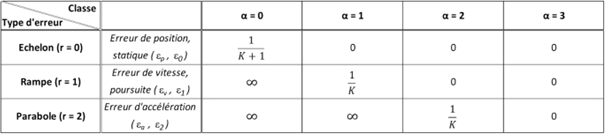

In [31]:
Image(filename="Sans titre.png")

KBO =  0.667
class =  1
Kp =  18.74062968515742

        93.7
--------------------
3 s^2 + 7.5 s + 93.7

tr5% = 2.392533061523246
Kp =  18.74062968515742

        93.7
--------------------
3 s^2 + 7.5 s + 93.7



tr5% = 2.392533061523246


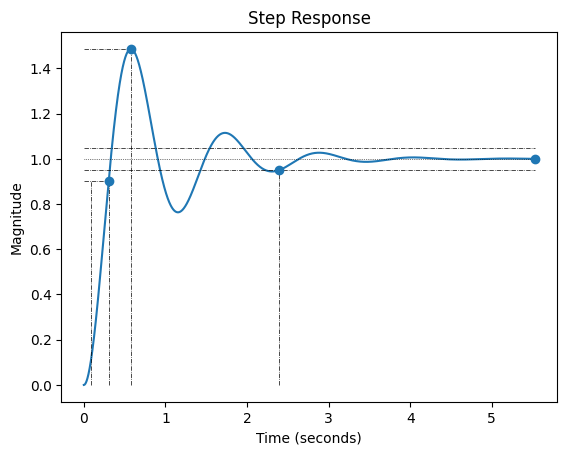

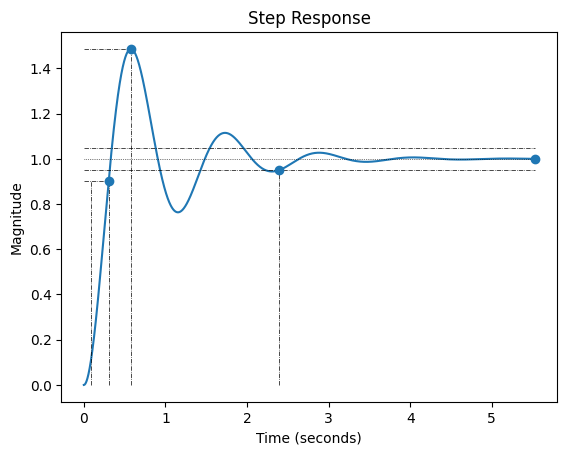

In [32]:
Donne_erreur = True #il y une erreur fixée dans l'énoncé : ev = 0.06 ou ea = 0.08
erreur_p = False
erreur_v = True
erreur_a = False

print("KBO = ",K_BO)
print("class = ",sysclass)  

if Donne_erreur == True:    
    #Si classe 0
    if erreur_p == True:
        erreur_p = 0.08
        Kp = ((1/erreur_p)+1)/K_BO
        print("Kp = ",Kp)

    #Si classe 1 
    if erreur_v == True:
        erreur_v = 0.03
        Kp = (1/erreur_v)/K_BO
        print("Kp = ",Kp)
        if sysclass == 0:
            sysclass = 1

    #Si classe 2
    if erreur_a == True:
        erreur_a = 0.02
        Kp = (1/erreur_a)/K_BO
        print("Kp = ",Kp)
        if sysclass == 0:
            sysclass = 2
    C = Kp # Correcteur P
    G_BO_P = H_BO*C
    G_BF_P = ml.feedback(G_BO_P,1)
    print(G_BF_P)

    info=rlf.stepWithInfo(G_BF_P)
    print("tr5% =", info.SettlingTime)
         
else : 
    ok = True
    info=rlf.stepWithInfo(H_BF)
    tr_tampon = info.SettlingTime
    Kp = 1
    while ok == True:
        Kp = Kp + 0.1
        C = Kp # Correcteur P
        G_BO_P = H_BO*C
        G_BF_P = ml.feedback(G_BO_P,1)
        info=rlf.stepWithInfo(G_BF_P)
        tr = info.SettlingTime
        if tr < tr_tampon:
            tr_tampon = tr
        else:
            ok = False  
            Kp = Kp - 0.1
            C = Kp # Correcteur P
            G_BO_P = H_BO*C
            G_BF_P = ml.feedback(G_BO_P,1)
            info=rlf.stepWithInfo(G_BF_P)  



print("Kp = ",Kp)
print(G_BF_P)
fig_step = rlf.step(G_BF_P)
fig_step.show()
info=rlf.stepWithInfo(G_BF_P)
print("tr5% =", info.SettlingTime)
# Tracé du diagramme de Bode avec les marges de stabilité 
fig_bode = rlf.bode([H_BO, Kp*H_BO], margins=True)    # Génère le diagramme de Bode avec les marges de stabilité et le stocke dans la variable `fig_bode`
fig_bode.show()

# Tracé du diagramme de Nichols avec les marges de stabilité 
fig_nichols = rlf.nichols([H_BO, Kp*H_BO], margins=True)    # Génère le diagramme de Nichols avec les marges de stabilité  et le stocke dans la variable `fig_nichols`
fig_nichols.show()

### Verification du correcteur P 

e_v = 0.0800400000000252


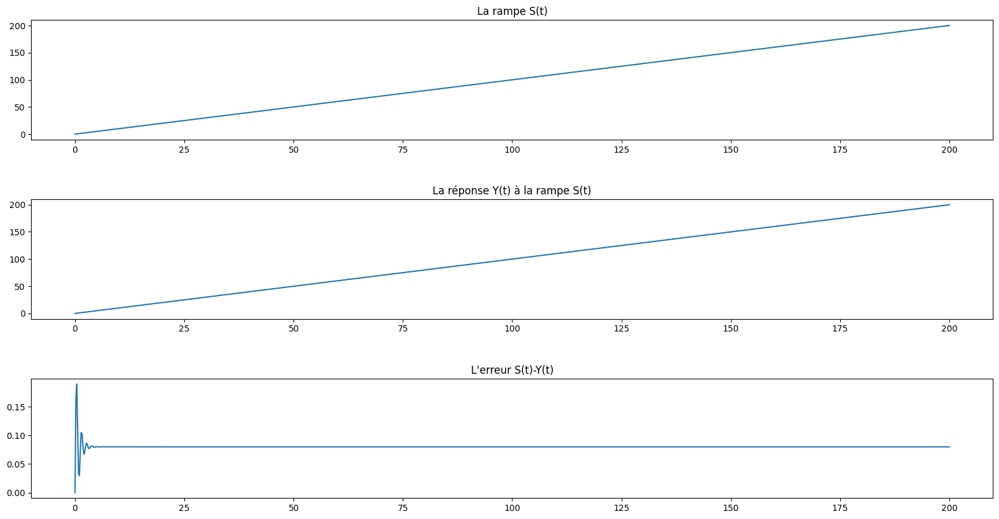

In [33]:

# Vérification de l'erreur de vitesse

# Génération du signal d'entrée de type rampe unitaire
t = np.linspace(0, 200, 1000)
s = t

# Simuler la réponse du système à la rampe de pente 1
[y, t, xout] = ml.lsim(G_BF_P,s,t)

# Affichage des graphes
plt.figure("Erreur de vitesse",figsize=(20,10))
plt.subplot(3,1,1); plt.plot(t,s); plt.title("La rampe S(t)")
plt.subplot(3,1,2); plt.plot(t,y); plt.title("La réponse Y(t) à la rampe S(t)")
plt.subplot(3,1,3); plt.plot(t,(s-y)); plt.title("L'erreur S(t)-Y(t)")
plt.subplots_adjust(hspace=0.5) # Pour laisser un peu d'espace pour les titres

# Impression de l'erreur de vitesse
print("e_v =", s[-1]-y[-1]) # L'élément "-1" d'une liste correspond au dernier de celle-ci


## Correcteur PD

$C(s)=K_p*(\tau_D*s+1)$

### Compensation du pôle dominant

Pôle dominant = plus grande cste de temps $\tau$

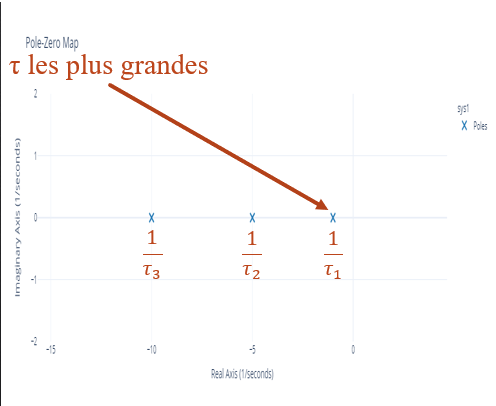

In [34]:
Image(filename="Pole dominant.png")

On calcule Kp comme au dessus et on trouve 

 Trouve $\tau_D = \frac{-1}{s_{min}}$ --> Calcule GBO puis GBF puis regarde par rapport où  ${s_{min}}$ est la valeur de la partie réelle du pôle dominant.


tau_d = 0.20833333333333334
Kd = 1.7352083333333335
Kd = 1.7352083333333335
G_BO = 
8.676 s + 41.65
---------------
 3 s^2 + 7.5 s

G_BF = 
    8.676 s + 41.65
-----------------------
3 s^2 + 16.18 s + 41.65



tr5% = 1.1113447203750977


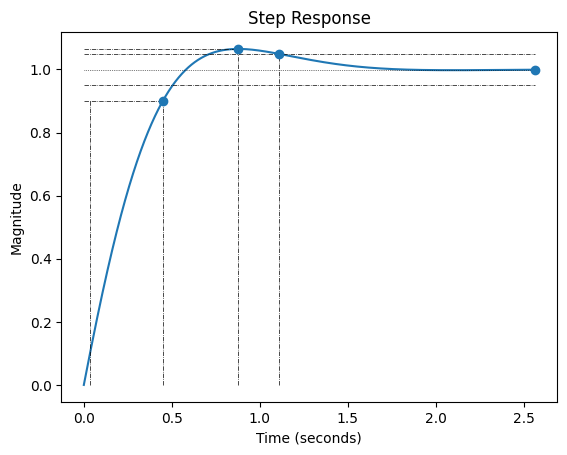

In [35]:
# Correcteur PD par la méthode de compensation du pôle dominant
Kp =8.329#[A compléter]
tau_1 = 1/2.4#[A compléter]
tau_2 = 1/2.4#[A compléter]
Td = tau_1*tau_2/(tau_1+tau_2)
print("tau_d =", Td)
Kd=Td*Kp
print("Kd =", Kd)

print("Kd =", Kd)

C = Kp*ml.tf([Td, 1],[1]) # Correcteur PD via Td
# C = Kp+ml.tf([Kd, 0],[1]) # Correcteur PD via Kd
G_BO_PD = C*H_BO
print("G_BO =", G_BO_PD)
G_BF_PD = ml.feedback(G_BO_PD,1)
print("G_BF =", G_BF_PD)
fig_step = rlf.step(G_BF_PD)
fig_step.show()

info=rlf.stepWithInfo(G_BF_PD)

fig_nichols = rlf.nichols([H_BO, Kp*H_BO], margins=True)
fig_nichols.show()
print("tr5% =", info.SettlingTime)


### Placement fréquentiel PD (avec un Kp déjà défini)

Car la fréquence de coupure W est celle voulue pour une certaine marge de phase voulue (MP)

Si pas de marge à atteindre précise on dimensionne taud par rapport à la fréquence de coupure du système actuelle Wc pour la trouver c'est simple on regrarde le Wc de la nouvelle courbe rapporté sur la de marge de phase. 
Exemple ici le point vert: 

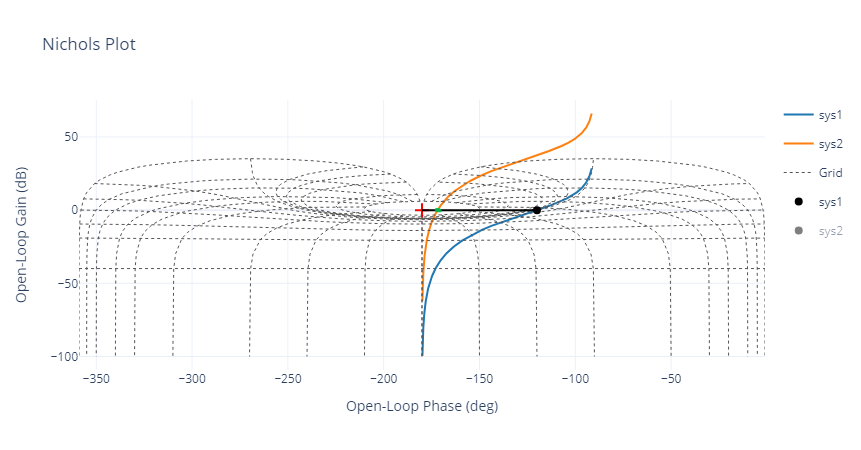

In [36]:
#image exemple Wc
Image(filename="Nichols_Wc.png")    

In [60]:
# Correcteur PD par la méthode de compensation du pôle dominant : Détermination de Td
Kp = 1 #[A compléter]

fig_nichols = rlf.nichols([H_BO, Kp*H_BO], margins=True)
fig_nichols.show()


Si on veut une marge de phase de 45°, en gardant le même Kp pour avoir la même erreur de vitesse

Gain à -143.103° = 7.0598541947205025 dB
Fréquence à -143.103° = 3.3285280810810236 rad/sec


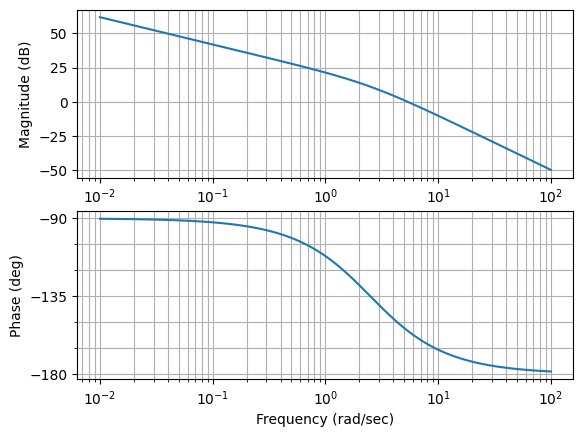

In [61]:
#en prenant la marge de phase du sys2
mgPhaseSys2 = 36.897
mag, wc=rlf.getValues(G_BO_P, -180+mgPhaseSys2, printValue=True, NameOfFigure="Bode")

But : trouver $\omega_c$ 

Regarde la marge de de phase et fait : $$\Phi = 180-M_\phi-84°$$ avec 84° = avance de phase par D

Trouve $\omega_c > \frac{10}{\tau_D}$



In [62]:
wc = 3.42 #[A compléter]
Td = 10/wc
print("tau_D = ",Td)
#tau_d represente le temps de dérivation du correcteur PD (Td) 

tau_D =  2.9239766081871346


In [63]:
Kd=Td*Kp
print("Kd =", Kd)

C = Kp*ml.tf([Td, 1],[1]) # Correcteur PD via Td
# C = Kp+ml.tf([Kd, 0],[1]) # Correcteur PD via Kd
G_BO_PD = C*H_BO
print("G_BO_PD =", G_BO_PD)
G_BF_PD = ml.feedback(G_BO_PD,1)
print("G_BF =", G_BF_PD)
fig_step = rlf.step(G_BF_PD)
fig_step.show()

fig_nichols = rlf.nichols([H_BO, Kp*H_BO,G_BO_PD], margins=True)
fig_nichols.show()

Kd = 2.9239766081871346
G_BO_PD = 
 14.62 s + 5
-------------
3 s^2 + 7.5 s

G_BF = 
    14.62 s + 5
-------------------
3 s^2 + 22.12 s + 5



### Verification du correcteur PD 

DCGain : 0.9996718176874801
Overshoot : 0.0
Peak : 0.9996718176874801
PeakTime : 29.592256500209558
RiseTime : 5.054862896525445
SettlingTime : 8.032141628319707
Les caractéristiques de performances typiques associées à sa réponse en boucle fermée sont : wn = 7.140 rad/s et zeta = 1.000.

Marge de gain =  inf , Marge de phase =  inf
Ordre =  2 , class =  0


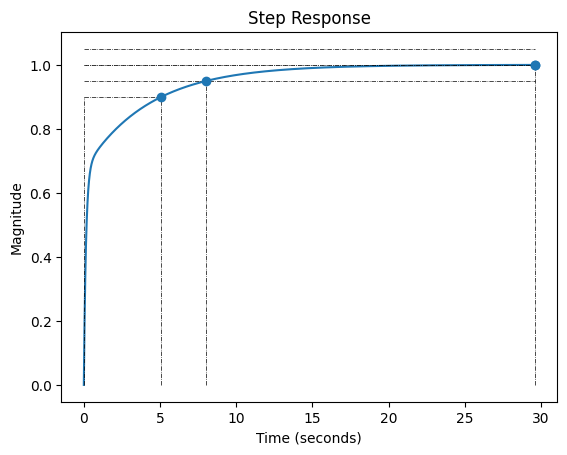

In [64]:
rlf.plot_speed_error(G_BF_PD);
rlf.step(G_BF_PD,plot_infos=True);
infos = rlf.stepWithInfo(G_BF_PD)
rlf.printInfo(infos)
wn, zeta, __ = ml.damp(G_BF_PD, doprint=False)
print("Les caractéristiques de performances typiques associées à sa réponse en boucle fermée sont : wn = {:.3f} rad/s et zeta = {:.3f}.\n".format(wn[0], zeta[0])) #exemple de print
mg, mp, __, __ = ml.margin(G_BF_PD)
print("Marge de gain = ", mg, ", Marge de phase = ", mp)
sysclass=rlf.getClass(G_BF_PD)
order=rlf.getOrder(G_BF_PD)
print("Ordre = ",order,", class = ",sysclass)


## Correcteur PI

$C(s)=K_p*\frac{\tau_I*s+1}{\tau_I*s}$

## Compensation pôle dominant

Grâce à l'erreur, on calcule KBO puis Kp. Trouve $\tau_I = \frac{-1}{s_{min}}$

Ki = 281.97879858657245
GBO =  
 2000 s + 1410
---------------
3 s^3 + 7.5 s^2

GBF =  
         2000 s + 1410
-------------------------------
3 s^3 + 7.5 s^2 + 2000 s + 1410



erreur de vitesse e_v = 8.526512829121202e-14


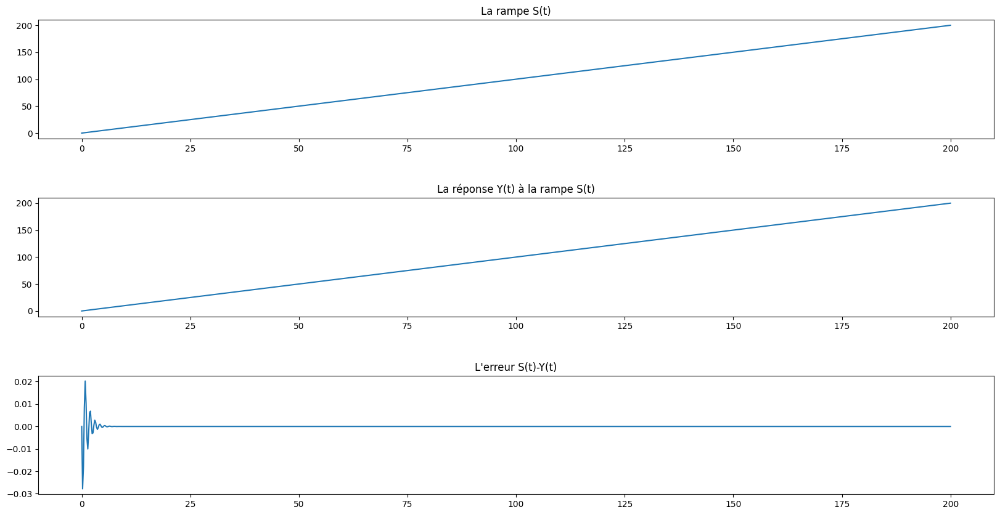

In [65]:
Kp=400
tau_1=1/1.33 #A définir
tau_2=1/1.5 #A définir
Ti= tau_1+tau_2
Ki = Kp/Ti
print("Ki =", Ki)

#C = Kp*ml.tf([Ti, 1],[Ti, 0]) # Correcteur PI via Ti
C = Kp+ml.tf([Ki],[1, 0]) # Correcteur PI via Ki
G_BO_PI = C*H_BO                       #Gain boucle ouverte = gain correcteur C (PI) * gain HBO
print("GBO = ",G_BO_PI)
G_BF_PI = ml.feedback(G_BO_PI,1)          #Gain boucle fermé
print("GBF = ",G_BF_PI)
fig_step = rlf.step(G_BF_PI,plot_infos=True)
fig_step.show()


# Vérification de l'erreur de vitesse

# Génération du signal d'entrée de type rampe unitaire
t = np.linspace(0, 200, 1000)
s = t

# Simuler la réponse du système à la rampe de pente 1
[y, t, xout] = ml.lsim(G_BF_PI,s,t)

# Affichage des graphes 
plt.figure("Erreur de vitesse",figsize=(20,10))
plt.subplot(3,1,1); plt.plot(t,s); plt.title("La rampe S(t)")
plt.subplot(3,1,2); plt.plot(t,y); plt.title("La réponse Y(t) à la rampe S(t)")
plt.subplot(3,1,3); plt.plot(t,(s-y)); plt.title("L'erreur S(t)-Y(t)")
plt.subplots_adjust(hspace=0.5) # Pour laisser un peu d'espace pour les titres

# Impression de l'erreur de vitesse
print("erreur de vitesse e_v =", s[-1]-y[-1]) # L'élément "-1" d'une liste correspond au dernier de celle-ci



In [66]:
# Vérification de la réponse fréquentielle avant et après correction
fig_nichols = rlf.nichols([H_BO, G_BO_PI], margins=True)
fig_nichols.show()

### Placement fréquentiel

In [67]:
#H_BO en bleu et HBO*Kp en orange (correcteur P) --> pour trouver fréquence de coupure 
KP = 9.198
fig_nichols = rlf.nichols([H_BO,H_BO*KP], margins=True)
fig_nichols.show()



In [68]:
# Correcteur PI par la méthode du placement fréquentiel     en vert : correcteur PI
Kp=9.198
wc = 25.724
Ti = 10/wc                  #à la fréquence de coupure (Ti>10/wc)
print("Tau i [s] > ",Ti)
Ki=KP/Ti
print("Ki = ",Ki)
C = Kp*ml.tf([Ti, 1],[Ti, 0]) # Correcteur PI via Ti
G_BO_PI = C*H_BO
G_BF_PI = ml.feedback(G_BO_PI,1)
fig_nichols = rlf.nichols([H_BO, Kp*H_BO, G_BO_PI], margins=True)
fig_nichols.show()

Tau i [s] >  0.38874203078836883
Ki =  23.6609352


### Verification du correcteur PI 

DCGain : -829.3946927964205
Overshoot : -217.10266194164706
Peak : 971.2432632673545
PeakTime : 270.86365129747173
RiseTime : 0.0
SettlingTime : 271.8150992897852
Les caractéristiques de performances typiques associées à sa réponse en boucle fermée sont : wn = 3.932 rad/s et zeta = -0.006.

Marge de gain =  inf , Marge de phase =  -1.2365168405669351
Ordre =  3 , class =  0


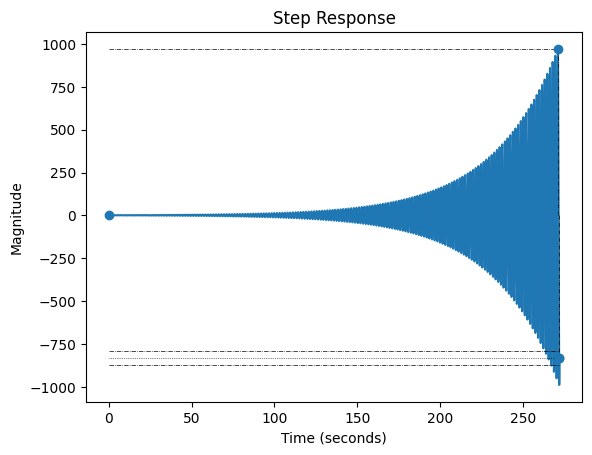

In [69]:

rlf.plot_speed_error(G_BF_PI);
rlf.step(G_BF_PI,plot_infos=True);
infos = rlf.stepWithInfo(G_BF_PI)
rlf.printInfo(infos)
wn, zeta, __ = ml.damp(G_BF_PI, doprint=False)
print("Les caractéristiques de performances typiques associées à sa réponse en boucle fermée sont : wn = {:.3f} rad/s et zeta = {:.3f}.\n".format(wn[0], zeta[0])) #exemple de print
mg, mp, __, __ = ml.margin(G_BF_PI)
print("Marge de gain = ", mg, ", Marge de phase = ", mp)
sysclass=rlf.getClass(G_BF_PI)
order=rlf.getOrder(G_BF_PI)
print("Ordre = ",order,", class = ",sysclass)


### Correcteur PID

La fonction de transfert du correcteur est donc : 

$$\begin{alignat*}{2}
\begin{aligned}
C(s)=K_P + \frac{K_I}{s} + K_D \cdot s = K_P \cdot (1 + \frac{1}{\tau_I \cdot s} + \tau_D \cdot s) \qquad avec \quad 
\end{aligned}
\left\{ \begin{aligned}
    \begin{array}{ll}
        \tau_I =\frac{K_P}{K_I} \\
        \tau_D =\frac{K_D}{K_P}
    \end{array}
\end{aligned}\right.
\end{alignat*}\
$$

Td =  0.3533568904593639
Ti =  1.418546365914787
C =  
70.67 s^2 + 200 s + 141
-----------------------
           s

DCGain : 1.0000647054444898
Overshoot : 0.45354956793985934
Peak : 1.0046004945951523
PeakTime : 0.5094333877512227
RiseTime : 0.018613912244756215
SettlingTime : 0.024981829591646496


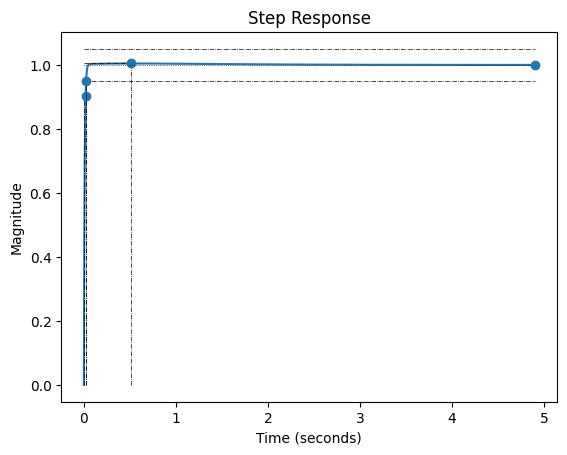

In [70]:

Kp=200
#pôles dominant
tau_1= 1/1.33
tau_2= 1/1.5

#Règles de compensation (forme serie)
tau_i=tau_1
tau_d=tau_2

#paramètre en série
Kc = Kp / (1+(tau_d/tau_i))

#paramètres forme standard
Ti=tau_1+tau_2
Td=tau_1*tau_2/(tau_1+tau_2)
print("Td = ",Td)
print("Ti = ",Ti)


Kd = Kp*Td
Ki = Kp/Ti
C = Kp + ml.tf(Ki, [1, 0]) + ml.tf([Kd, 0], 1) # PID corrector
print("C = ",C)
G_BO_init = C*H_BO # Application of the corrector on the system
G_BF_init = ml.feedback(G_BO_init, 1)   # Servoing with a unitary feedback


infos = rlf.stepWithInfo(G_BF_init)
rlf.printInfo(infos)


step_fig = rlf.step([H_BF,G_BF_init],plot_infos=True);
step_fig.show()
nichols_fig = rlf.nichols([H_BO, G_BO_init], margins=True);
nichols_fig.show()
#nyquist_fig = rlf.nyquist([H_BO, G_BO_init]);
#il pue celui-là nyquist_fig.show()
#bode_fig = rlf.bode([H_BO, G_BO_init], margins=True);
#bode_fig.show()

#bleu = sans PID
#Orange = avec PID



In [71]:
rlf.plot_speed_error(G_BF_PID);
rlf.step(G_BF_PID,plot_infos=True);
infos = rlf.stepWithInfo(G_BF_PID)
rlf.printInfo(infos)
wn, zeta, __ = ml.damp(G_BF_PID, doprint=False)
print("Les caractéristiques de performances typiques associées à sa réponse en boucle fermée sont : wn = {:.3f} rad/s et zeta = {:.3f}.\n".format(wn[0], zeta[0])) #exemple de print
mg, mp, __, __ = ml.margin(G_BF_PID)
print("Marge de gain = ", mg, ", Marge de phase = ", mp)
sysclass=rlf.getClass(G_BF_PID)
order=rlf.getOrder(G_BF_PID)
print("Ordre = ",order,", class = ",sysclass)


NameError: name 'G_BF_PID' is not defined

### Gain KP en fct de la marge 

In [ ]:
# Phase pour laquelle nous voulons trouver le gain (en degrés) 

phase_cible = -90
# exemple de phase cible 

# Calcul de la réponse en fréquence du système 

omega = np.logspace(-2, 2, 1000) 
# Plage de fréquences pour l'analyse 
mag, phase, omega = ml.bode(G_BO, omega, Plot=False) 
# Obtention des diagrammes de Bode sans affichage 

# Conversion de la phase en degrés
phase_deg = np.degrees(phase) 
# Interpolation pour trouver le gain à la phase donnée 
gain_interpolé = np.interp(phase_cible, phase_deg[::-1], mag[::-1]) 
# Conversion du gain de magnitude à décibels 
gain_db = 20 * np.log10(gain_interpolé) 
print(f"Gain à la phase de {phase_cible} degrés: {gain_db:.4f} dB.") 

# Calcul du Kp à partir du gain en décibels 
Kp = 10**(-gain_db / 20) 
print(f"Kp à ajouter pour obtenir une marge de phase de {phase_cible} degrés: {Kp:.4f}") 

 

In [ ]:
mag, w = rlf.getValues(G_BO, -135, NameOfFigure="Bode Gbo") # -135° car on souhaite regarder le gain du système en BO à 45° du point critique (-180°, 0dB)
Kp = 1/mag  # Donne directement la valeur de l'amplitude => Pas besoin de la convertir à partir d'une valeur en dB + Kp va à l'inverse de ce qu'on mesure
print("Kp =", Kp)


### Tracé de la réponse indicielle et vérifications

In [ ]:

rlf.step(G_BF, plot_infos=True);
rlf.pzmap([G_BO], sys_names=['G_BO']);

rlf.nichols([G_BF], ['G_BF'], margins=True);
rlf.bode(G_BF, margins=True);
rlf.plot_speed_error(G_BF);

infos = rlf.stepWithInfo(G_BF_PD);
rlf.printInfo(infos);

wn, zeta, __ = ml.damp(G_BF_PD, doprint=False);
print("Les caractéristiques de performances typiques associées à sa réponse en boucle fermée sont : wn = {:.3f} rad/s et zeta = {:.3f}.\n".format(wn[0], zeta[0])) #exemple de print

mg, mp, __, __ = ml.margin(G_BF_PD);
print("Marge de gain = ", mg, ", Marge de phase = ", mp)


In [ ]:
# Définition de l'indice pour le calcul du dépassement
k = 1

# Calcul de l'amplitude du deuxième dépassement
Dk = 100 * exp(-k * pi * zeta[1] / (sqrt(1 - (zeta[1]**2))))

# Affichage de l'amplitude du deuxième dépassement
print("Amplitude (en pourcent) du ", k, "ème dépassement = ", Dk)

# Calcul de l'amplitude du dépassement en valeur absolue
Ak = (infos.DCGain) * (1 - Dk / 100)

# Affichage de l'amplitude du dépassement en valeur absolue
print("L'amplitude 'en valeur absolue) du ", k, "ème dépassement = ", Ak)

# Calcul de l'instant du deuxième dépassement
tk = k * pi / (wn[1] * sqrt(1 - zeta[1]**2))

# Affichage de l'instant du deuxième dépassement
print("L'instant (en seconde) du ", k, "ème dépassement = ", tk)


### Tracé de la réponse indicielle